# Exploring the Relationship between Air Quality and Greenhouse Gas Emissions: A Data Analysis Approach

---

## Introduction:

- **Group Members**: Chongye Feng, Yiyao Guo
- **Date**: May 2023

Air quality and greenhouse gas emissions are critical environmental factors that have a significant impact on public health and climate change. In this analysis, we aim to explore the relationship between air quality and greenhouse gas emissions (from facilities) using data analysis techniques. By analyzing relevant datasets, we aim to gain insights into how different factors influence air quality and greenhouse gas emissions.

The primary datasets used for this analysis include:
- `us_greenhouse_gas_emissions_direct_emitter_facilities.csv`: This dataset contains information about greenhouse gas emissions from direct emitter facilities in the United States.
- `us_greenhouse_gas_emission_direct_emitter_gas_type.csv`: This dataset provides details about different types of greenhouse gases emitted by direct emitter facilities.
- `annual_aqi_by_county_2020.csv`: This dataset includes air quality index (AQI) data for different counties in the United States for the year 2020.

By performing exploratory data analysis, preprocessing, and modeling, we aim to uncover patterns, correlations, and insights related to air quality and greenhouse gas emissions. Furthermore, we will discuss the results obtained and provide recommendations for policymakers based on the findings.

---

## Table of Contents:
1. Data Loading and Exploration
2. Facility Density Map
3. Data Preprocessing and Feature Engineering
4. County-level Analysis: Facility Density and Good Air Quality Percentage
5. Correlation Analysis of Air Quality Index (AQI)
6. Modeling: Predicting Percentage of Good Air Quality Days
   - 6.1 Linear Regression Model
   - 6.2 Comparison of Different Models
   - 6.3 Predicting Percentage of Good Days Using Linear Regression Model
7. Discussion

Now, let's dive into each section of the analysis, starting with data loading and exploration.

---

## Data Loading and Exploration

In [1]:
# importing essential libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as mpl

import folium
from folium.plugins import MarkerCluster

from sklearn.linear_model import LinearRegression

In [ ]:
# loading data
facilities_df = pd.read_csv('../data/raw/us_greenhouse_gas_emissions_direct_emitter_facilities.csv')
gas_type_df = pd.read_csv('../data/raw/us_greenhouse_gas_emission_direct_emitter_gas_type.csv')
aqi_2020_df = pd.read_csv('../data/raw/annual_aqi_by_county_2020.csv')

<ipython-input-2-a9c43831e0f2>:2: DtypeWarning: Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.
  facilities_df = pd.read_csv('../data/us_greenhouse_gas_emissions_direct_emitter_facilities.csv')


In [3]:
facilities_df.head(3)

,V_GHG_EMITTER_FACILITIES.ADDRESS1,V_GHG_EMITTER_FACILITIES.ADDRESS2,V_GHG_EMITTER_FACILITIES.CEMS_USED,V_GHG_EMITTER_FACILITIES.CITY,V_GHG_EMITTER_FACILITIES.COUNTY,V_GHG_EMITTER_FACILITIES.COUNTY_FIPS,V_GHG_EMITTER_FACILITIES.FACILITY_ID,V_GHG_EMITTER_FACILITIES.LATITUDE,V_GHG_EMITTER_FACILITIES.LONGITUDE,V_GHG_EMITTER_FACILITIES.PRIMARY_NAICS_CODE,...,V_GHG_EMITTER_FACILITIES.STATE_NAME,V_GHG_EMITTER_FACILITIES.YEAR,V_GHG_EMITTER_FACILITIES.ZIP,V_GHG_EMITTER_FACILITIES.FACILITY_NAME,V_GHG_EMITTER_FACILITIES.SECONDARY_NAICS_CODE,V_GHG_EMITTER_FACILITIES.ADDITIONAL_NAICS_CODES,V_GHG_EMITTER_FACILITIES.COGENERATION_UNIT_EMISS_IND,V_GHG_EMITTER_FACILITIES.EPA_VERIFIED,V_GHG_EMITTER_FACILITIES.PARENT_COMPANY,V_GHG_EMITTER_FACILITIES.PLANT_CODE_INDICATOR
0,301 Commerce Dr. Suite 3701,NaN,NaN,Fort Worth,NaN,NaN,1008536.0,35.533760,-97.529760,211111.0,...,TEXAS,2012.0,76102.0,TEP Barnett USA LLC 415 - Strawn Basin,NaN,NaN,N,NaN,CHESAPEAKE ENERGY CORP (100%),NaN
1,449 Shell E&P Court,NaN,NaN,Gibson,TERREBONNE,22109.0,1005071.0,29.628790,-90.917680,211112.0,...,LOUISIANA,2011.0,70358.0,North Terrebonne Gas Plant,NaN,NaN,N,NaN,ENTERPRISE GAS PROCESSING LLC (64.19%); DCP M...,NaN
2,5494 MALONE ROAD,NaN,NaN,MEMPHIS,SHELBY COUNTY,47157.0,1002466.0,34.999213,-89.906724,562212.0,...,TENNESSEE,2017.0,38116.0,SOUTH SHELBY LANDFILL,NaN,NaN,N,NaN,REPUBLIC SERVICES INC (100%),N


In [4]:
# cleaning-up the titles
for title in list(facilities_df.columns):
    facilities_df.rename(columns={title: title[25:]}, inplace=True)
for title in list(gas_type_df.columns):
    gas_type_df.rename(columns={title: title[len('V_GHG_EMITTER_GAS.'):]}, inplace=True)

In [5]:
facilities_df.columns

Index(['ADDRESS1', 'ADDRESS2', 'CEMS_USED', 'CITY', 'COUNTY', 'COUNTY_FIPS',
       'FACILITY_ID', 'LATITUDE', 'LONGITUDE', 'PRIMARY_NAICS_CODE', 'STATE',
       'STATE_NAME', 'YEAR', 'ZIP', 'FACILITY_NAME', 'SECONDARY_NAICS_CODE',
       'ADDITIONAL_NAICS_CODES', 'COGENERATION_UNIT_EMISS_IND', 'EPA_VERIFIED',
       'PARENT_COMPANY', 'PLANT_CODE_INDICATOR'],
      dtype='object')

In [6]:
gas_type_df.columns

Index(['ADDRESS1', 'ADDRESS2', 'CITY', 'CO2E_EMISSION', 'COUNTY',
       'FACILITY_ID', 'GAS_CODE', 'GAS_NAME', 'LATITUDE', 'LONGITUDE', 'STATE',
       'STATE_NAME', 'YEAR', 'ZIP', 'FACILITY_NAME', 'COUNTY_FIPS'],
      dtype='object')

In [7]:
gas_names = gas_type_df['GAS_NAME'].unique()

print(gas_names)

['Biogenic CO2' 'Methane' 'Nitrous Oxide' 'Carbon Dioxide'
 'Sulfur Hexafluoride' 'Other Fully Fluorinated GHGs' 'PFCs' 'HFCs'
 'Very Short-lived Compounds' 'HFEs' 'Nitrogen Triflouride' 'Other']


In [8]:
aqi_2020_df.columns

Index(['State', 'County', 'Year', 'Days with AQI', 'Good Days',
       'Moderate Days', 'Unhealthy for Sensitive Groups Days',
       'Unhealthy Days', 'Very Unhealthy Days', 'Hazardous Days', 'Max AQI',
       '90th Percentile AQI', 'Median AQI', 'Days CO', 'Days NO2',
       'Days Ozone', 'Days SO2', 'Days PM2.5', 'Days PM10'],
      dtype='object')

---

## Facility Density Maps

In [9]:
latitude = 39.8283
longitude = -98.5795
zoom_level = 4

map = folium.Map(location=[latitude, longitude], zoom_start=zoom_level)

In [10]:
marker_cluster = MarkerCluster().add_to(map)

facilities_df.dropna(subset=['LATITUDE', 'LONGITUDE'], inplace=True)

for index, row in facilities_df.iterrows():
    folium.Marker(location=[row['LATITUDE'], row['LONGITUDE']]).add_to(marker_cluster)
    
map

After mapping the Facility Density Map using the `facilities_df`, we observed distinct patterns of facility densities across the United States. The map provides valuable insights into the distribution of greenhouse gas emission facilities and highlights areas of high concentration. Here are some key observations:

1. **East and West Coasts**: The map indicates a higher density of facilities along the eastern and western coastlines. This observation aligns with the concentration of industrial and urban areas in these regions, where higher emissions are expected due to population density and economic activities.

2. **Lakes Area**: We noticed a notable density of facilities around the Great Lakes region. This finding suggests a significant presence of industrial and manufacturing activities in this area, potentially contributing to higher greenhouse gas emissions.

3. **Texas**: The state of Texas stands out as an area with a substantial concentration of facilities. This observation can be attributed to the state's large size, diverse industries, and energy sector, including oil and gas production.

4. **Urban Centers**: Major urban centers, such as New York City, Los Angeles, Chicago, and Houston, exhibit higher facility densities. These densely populated areas often have numerous industrial facilities, power plants, and transportation hubs, resulting in increased emissions.

This initial analysis of the Facility Density Map provides a broad overview of the distribution of greenhouse gas emission facilities in the United States. The observed patterns can guide further investigations into the factors influencing emissions, potential environmental impacts, and targeted mitigation strategies in specific regions.

---

## Data Preprocessing and Feature Engineering

The provided code performs one-hot encoding on the 'GAS_NAME' column of the 'gas_type_df' DataFrame using the `OneHotEncoder` object. The encoded gas names are then concatenated with the original DataFrame to create 'gas_type_encoded_df'. Finally, the code groups 'gas_type_encoded_df' by 'COUNTY_FIPS' and calculates the count of each gas type, resulting in the 'gas_type_count' DataFrame. This analysis allows for further exploration of the distribution of gas types across counties.

In [11]:
from sklearn.preprocessing import OneHotEncoder

# Create the OneHotEncoder object
encoder = OneHotEncoder()

# Fit the encoder to the GAS_NAME column
encoder.fit(gas_type_df[['GAS_NAME']])

# Transform the GAS_NAME column
encoded_gas_names = encoder.transform(gas_type_df[['GAS_NAME']])

# Convert the encoded gas names to a DataFrame
gas_names_df = pd.DataFrame(encoded_gas_names.toarray(), columns=encoder.get_feature_names_out(['GAS_NAME']))

# Concatenate the gas_names_df with the original gas_type_df
gas_type_encoded_df = pd.concat([gas_type_df, gas_names_df], axis=1)

gas_type_count = gas_type_encoded_df.groupby('COUNTY_FIPS')[['GAS_NAME_Biogenic CO2', 'GAS_NAME_Carbon Dioxide', 'GAS_NAME_HFCs', 'GAS_NAME_HFEs', 'GAS_NAME_Methane', 'GAS_NAME_Nitrous Oxide', 'GAS_NAME_Other', 'GAS_NAME_Other Fully Fluorinated GHGs', 'GAS_NAME_PFCs', 'GAS_NAME_Sulfur Hexafluoride', 'GAS_NAME_Very Short-lived Compounds']].sum()

gas_type_count

,GAS_NAME_Biogenic CO2,GAS_NAME_Carbon Dioxide,GAS_NAME_HFCs,GAS_NAME_HFEs,GAS_NAME_Methane,GAS_NAME_Nitrous Oxide,GAS_NAME_Other,GAS_NAME_Other Fully Fluorinated GHGs,GAS_NAME_PFCs,GAS_NAME_Sulfur Hexafluoride,GAS_NAME_Very Short-lived Compounds
COUNTY_FIPS,,,,,,,,,,,
1001.0,10.0,40.0,0.0,0.0,58.0,40.0,0.0,0.0,0.0,0.0,0.0
1003.0,0.0,0.0,0.0,0.0,10.0,0.0,0.0,0.0,0.0,0.0,0.0
1005.0,0.0,10.0,0.0,0.0,9.0,9.0,0.0,0.0,0.0,0.0,0.0
1009.0,0.0,9.0,0.0,0.0,18.0,9.0,0.0,0.0,0.0,0.0,0.0
1015.0,1.0,52.0,0.0,0.0,50.0,48.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
72137.0,3.0,20.0,0.0,0.0,20.0,16.0,0.0,0.0,0.0,0.0,0.0
72145.0,0.0,4.0,0.0,0.0,4.0,4.0,0.0,0.0,0.0,0.0,0.0
72153.0,0.0,4.0,0.0,0.0,8.0,0.0,0.0,0.0,0.0,0.0,0.0


---

## County-level Analysis: Facility Density and Good Air Quality Percentage

And then, we group the 'facilities_df' DataFrame by 'COUNTY_FIPS' and aggregate the data to calculate the count of facilities ('FACILITY_ID') in each county. The resulting 'facilities_county_count' DataFrame provides a summary of the facility counts, along with the corresponding county name and state. This analysis helps us understand the distribution of facilities across counties and provides insights into the density of greenhouse gas emission sources in different regions.

In [12]:
facilities_county_count = facilities_df.groupby('COUNTY_FIPS').agg({
    'COUNTY': 'first',
    'STATE': 'first',
    'FACILITY_ID': 'count'
}).reset_index()

facilities_county_count

,COUNTY_FIPS,COUNTY,STATE,FACILITY_ID
0,1001.0,Autauga,AL,40
1,1003.0,BALDWIN COUNTY,AL,10
2,1005.0,BARBOUR COUNTY,AL,10
3,1009.0,BLOUNT COUNTY,AL,9
4,1015.0,CALHOUN COUNTY,AL,50
...,...,...,...,...
2070,72137.0,TOA BAJA MUNICIPIO,PR,20
2071,72145.0,VEGA BAJA,PR,4
2072,72153.0,YAUCO MUNICIPIO,PR,8
2073,78010.0,ST. CROIX ISLAND,VI,29


In [13]:
# Merge the gas_type and facilities_count, the TOTAL_FACILITIES could be from FACILITY_ID
county_facilities_count = pd.merge(facilities_county_count, gas_type_count, on='COUNTY_FIPS')
county_facilities_count = county_facilities_count.rename(columns={'FACILITY_ID': 'TOTAL_FACILITIES'})

# Grouping the aqi_2020_df to have a PERCENTAGE_GOOD_DAYS
aqi_2020_grouped = aqi_2020_df.groupby(['State', 'County']).apply(lambda x: (x['Good Days']/x['Days with AQI']).mean()*100).reset_index()
aqi_2020_grouped.rename(columns={0:'PERCENTAGE_GOOD_DAYS'}, inplace=True)
aqi_2020_grouped

,State,County,PERCENTAGE_GOOD_DAYS
0,Alabama,Baldwin,92.936803
1,Alabama,Clay,91.666667
2,Alabama,DeKalb,96.153846
3,Alabama,Elmore,100.000000
4,Alabama,Etowah,93.525180
...,...,...,...
1035,Wyoming,Sublette,81.147541
1036,Wyoming,Sweetwater,65.027322
1037,Wyoming,Teton,86.885246
1038,Wyoming,Uinta,88.251366


In the code above, we merge the 'facilities_county_count' DataFrame, which contains the count of facilities in each county, with the 'gas_type_count' DataFrame based on the 'COUNTY_FIPS' column. This merged DataFrame is then renamed to 'county_facilities_count', with the 'FACILITY_ID' column renamed to 'TOTAL_FACILITIES' for clarity.

Next, we group the 'aqi_2020_df' DataFrame by 'State' and 'County' and calculate the average percentage of good air quality days ('PERCENTAGE_GOOD_DAYS') for each county. The resulting DataFrame is assigned to 'aqi_2020_grouped'.

It is important to note that there might be inconsistencies in the naming style between the 'county_facilities_count' DataFrame and the 'aqi_2020_grouped' DataFrame regarding county and state names. This discrepancy should be addressed to ensure accurate analysis and further exploration of the data.

In [14]:
# Load the mapping file that contains the county names and their FIPS codes
county_mapping_df = pd.read_csv('../data/county_mapping.csv')
county_mapping_df = county_mapping_df.rename(columns={'StateName': 'State', 'CountyName': 'County'})


# Merge the mapping file with the aqi_2020_grouped df based on the county name
aqi_2020_mapped_df = aqi_2020_grouped.merge(county_mapping_df, on=['State', 'County'], how='left')

# Drop the original county name column and rename the FIPS column to 'County_FIPS'
aqi_2020_mapped_df = aqi_2020_mapped_df.rename(columns={'CountyFIPS': 'County_FIPS'})

aqi_2020_mapped_df = aqi_2020_mapped_df[['State', 'County', 'County_FIPS', 'PERCENTAGE_GOOD_DAYS']]
aqi_2020_mapped_df

,State,County,County_FIPS,PERCENTAGE_GOOD_DAYS
0,Alabama,Baldwin,1003.0,92.936803
1,Alabama,Clay,1027.0,91.666667
2,Alabama,DeKalb,1049.0,96.153846
3,Alabama,Elmore,1051.0,100.000000
4,Alabama,Etowah,1055.0,93.525180
...,...,...,...,...
1035,Wyoming,Sublette,56035.0,81.147541
1036,Wyoming,Sweetwater,56037.0,65.027322
1037,Wyoming,Teton,56039.0,86.885246
1038,Wyoming,Uinta,56041.0,88.251366


To solve the inconsistence issue, we imported a file `county_mapping.csv` from the URL 'https://github.com/ChuckConnell/articles/blob/master/fips2county.tsv'. This file serves as a county mapping file, containing county names and their corresponding FIPS codes.

By merging this mapping file with the 'aqi_2020_grouped' DataFrame based on the county name, we ensure consistency in the naming style. This allows for accurate analysis and exploration of the relationship between facility counts, gas types, and air quality at the county level.

In [15]:
aqi_2020_mapped_df = aqi_2020_mapped_df.rename(columns={'County_FIPS': 'COUNTY_FIPS'})
polished_df = aqi_2020_mapped_df.merge(county_facilities_count, on=['COUNTY_FIPS'], how='left')
polished_df = polished_df.drop(['COUNTY', 'STATE'], axis=1)

polished_df.dropna(subset=['TOTAL_FACILITIES'], inplace=True)

polished_df

,State,County,COUNTY_FIPS,PERCENTAGE_GOOD_DAYS,TOTAL_FACILITIES,GAS_NAME_Biogenic CO2,GAS_NAME_Carbon Dioxide,GAS_NAME_HFCs,GAS_NAME_HFEs,GAS_NAME_Methane,GAS_NAME_Nitrous Oxide,GAS_NAME_Other,GAS_NAME_Other Fully Fluorinated GHGs,GAS_NAME_PFCs,GAS_NAME_Sulfur Hexafluoride,GAS_NAME_Very Short-lived Compounds
0,Alabama,Baldwin,1003.0,92.936803,10.0,0.0,0.0,0.0,0.0,10.0,0.0,0.0,0.0,0.0,0.0,0.0
2,Alabama,DeKalb,1049.0,96.153846,10.0,0.0,4.0,0.0,0.0,10.0,0.0,0.0,0.0,0.0,0.0,0.0
3,Alabama,Elmore,1051.0,100.000000,8.0,0.0,6.0,0.0,0.0,8.0,6.0,0.0,0.0,0.0,0.0,0.0
4,Alabama,Etowah,1055.0,93.525180,14.0,9.0,14.0,0.0,0.0,18.0,14.0,0.0,0.0,0.0,0.0,0.0
5,Alabama,Jefferson,1073.0,57.923497,194.0,2.0,151.0,0.0,0.0,200.0,130.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1034,Wyoming,Sheridan,56033.0,93.989071,22.0,0.0,22.0,0.0,0.0,20.0,20.0,0.0,0.0,0.0,0.0,0.0
1035,Wyoming,Sublette,56035.0,81.147541,48.0,0.0,48.0,0.0,0.0,44.0,43.0,0.0,0.0,0.0,0.0,0.0
1036,Wyoming,Sweetwater,56037.0,65.027322,198.0,0.0,211.0,0.0,0.0,198.0,198.0,0.0,0.0,0.0,0.0,0.0
1038,Wyoming,Uinta,56041.0,88.251366,53.0,0.0,54.0,0.0,0.0,53.0,53.0,0.0,0.0,0.0,0.0,0.0


**FINALLY!** We can take our final steps for out polished data frame.

The resulting 'polished_df' DataFrame represents our ultimate polished dataset. It contains information such as the state, county, county FIPS code, percentage of good air quality days ('PERCENTAGE_GOOD_DAYS'), total facilities count ('TOTAL_FACILITIES'), and counts of different gas types. This dataset provides a comprehensive overview of the relationship between facility densities, gas emissions, and air quality at the county level.

---

## Correlation Analysis of Air Quality Index (AQI)

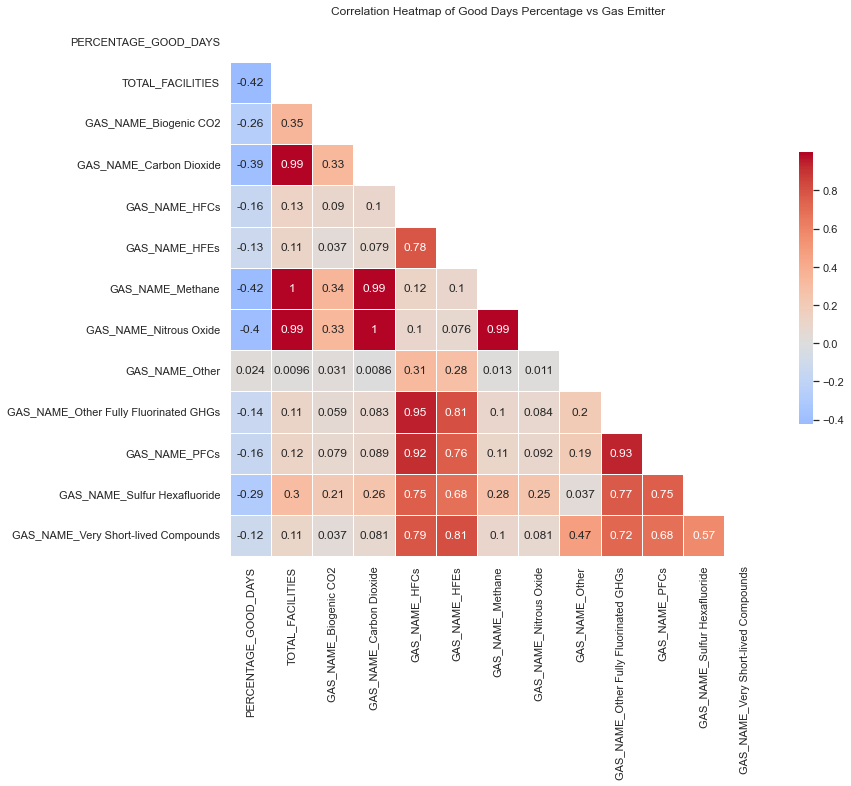

In [16]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define the columns to correlate
cols_to_correlate = ['PERCENTAGE_GOOD_DAYS', 'TOTAL_FACILITIES', 'GAS_NAME_Biogenic CO2', 
                     'GAS_NAME_Carbon Dioxide', 'GAS_NAME_HFCs', 'GAS_NAME_HFEs', 
                     'GAS_NAME_Methane', 'GAS_NAME_Nitrous Oxide', 'GAS_NAME_Other', 
                     'GAS_NAME_Other Fully Fluorinated GHGs', 'GAS_NAME_PFCs', 
                     'GAS_NAME_Sulfur Hexafluoride', 'GAS_NAME_Very Short-lived Compounds']

# Calculate the correlation matrix
corr_matrix = polished_df[cols_to_correlate].corr()

# Set the style and create the figure
sns.set(style='white')
fig, ax = plt.subplots(figsize=(12,10))

# Create a mask for the upper triangle of the heatmap
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

# Plot the correlation heatmap
sns.heatmap(corr_matrix, mask=mask, cmap='coolwarm', center=0, square=True, linewidths=.5, annot=True, cbar_kws={"shrink": .5})

# Set the title of the heatmap
plt.title('Correlation Heatmap of Good Days Percentage vs Gas Emitter')

# Save the heatmap as an image file
plt.savefig('../figures/correlation_heatmap.png')

Based on the correlation heatmap analysis, we observe several interesting findings regarding the relationship between air quality and greenhouse gas emissions:

1. Negative Relationship with Total Facilities: The percentage of good air quality days shows a negative correlation (-0.42) with the total number of facilities in a county. This suggests that an increase in the number of facilities may contribute to a decrease in the overall air quality. It implies that higher concentrations of greenhouse gas emitting facilities can have a detrimental effect on air quality.

2. Negative Relationship with Gas Types: Most of the gas types, except for 'Other' types, exhibit a negative correlation (-0.12 to -0.42) with the percentage of good air quality days. This indicates that counties with higher emissions of gases like carbon dioxide, methane, and nitrous oxide tend to have lower percentages of good air quality days. These gases are known to be significant contributors to climate change and can have adverse effects on air quality.

3. Dominance of Carbon Dioxide, Methane, and Nitrous Oxide: The correlation analysis reveals that carbon dioxide, methane, and nitrous oxide are the dominant greenhouse gases emitted by facilities in the dataset. These gases are well-known for their role in climate change and are potent contributors to global warming. The findings highlight the importance of addressing emissions from these gases to improve air quality and mitigate the impact of climate change.

Overall, the analysis suggests a clear connection between facility density, greenhouse gas emissions (particularly carbon dioxide, methane, and nitrous oxide), and air quality. Counties with a higher number of facilities and higher emissions of these gases tend to experience lower percentages of good air quality days. This emphasizes the need for effective strategies and policies to reduce emissions, promote sustainable practices, and improve air quality for the well-being of both human health and the environment.

---
## Modeling: Predicting Percentage of Good Air Quality Days

### Linear Regression Model

In this section, we will analyze the 'aqi_2020_df' dataset and build a Linear Regression model to predict the percentage of good air quality days. The dataset contains various air quality features such as Max AQI, 90th Percentile AQI, Median AQI, and the number of days with different pollutants. By utilizing the Linear Regression model, we aim to understand the key factors influencing air quality and their impact on the percentage of good days. Let's proceed with the implementation and evaluation of the model to gain insights into the relationship between air quality features and the percentage of good air quality days.

In [17]:
# Functions for the data frame processing
def remove_outliers(data, variable, lower=np.inf, upper=np.inf):
    return data[(data[variable]>lower) & (data[variable]<=upper)]

def remove_extreme(data, variable,indicator):
    return data[data[variable]/data['Days with AQI'] != indicator]

In [18]:
aqi_df_md = remove_outliers(aqi_2020_df, 'Days with AQI', lower=80)
aqi_df_md = remove_outliers(aqi_df_md, 'Days Ozone', lower=1)
aqi_df_md = remove_extreme(aqi_df_md, 'Good Days',1)

# add up unhealthy days
aqi_df_md['Unhealthy day total'] = aqi_df_md['Unhealthy for Sensitive Groups Days'] + aqi_df_md['Unhealthy Days'] + aqi_df_md['Very Unhealthy Days']

# substitute the different rating of the days into percentage of the day in AQI assessing
aqi_df_md['Good Days'] = aqi_df_md['Good Days']/aqi_df_md['Days with AQI']
aqi_df_md['Moderate Days'] = aqi_df_md['Moderate Days']/aqi_df_md['Days with AQI']
aqi_df_md['Unhealthy day total'] = aqi_df_md['Unhealthy day total']/aqi_df_md['Days with AQI']

# drop the original days
aqi_df_md = aqi_df_md.drop(columns = ['Unhealthy for Sensitive Groups Days','Unhealthy Days','Very Unhealthy Days','Hazardous Days'])
aqi_df_md

,State,County,Year,Days with AQI,Good Days,Moderate Days,Max AQI,90th Percentile AQI,Median AQI,Days CO,Days NO2,Days Ozone,Days SO2,Days PM2.5,Days PM10,Unhealthy day total
0,Alabama,Baldwin,2020,269,0.929368,0.070632,74,49,36,0,0,198,0,71,0,0.000000
2,Alabama,DeKalb,2020,364,0.961538,0.038462,90,45,36,0,0,331,0,33,0,0.000000
4,Alabama,Etowah,2020,278,0.935252,0.064748,92,46,34,0,0,204,0,74,0,0.000000
5,Alabama,Jefferson,2020,366,0.579235,0.412568,129,67,48,0,2,123,0,241,0,0.008197
7,Alabama,Madison,2020,364,0.843407,0.156593,88,54,40,0,0,132,0,227,5,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1035,Wyoming,Sublette,2020,366,0.811475,0.174863,151,61,44,0,0,355,0,11,0,0.013661
1036,Wyoming,Sweetwater,2020,366,0.650273,0.316940,1250,76,46,0,5,253,0,7,101,0.030055
1037,Wyoming,Teton,2020,366,0.868852,0.098361,161,54,42,0,0,329,0,37,0,0.032787
1038,Wyoming,Uinta,2020,366,0.882514,0.112022,122,51,40,0,2,225,0,0,139,0.005464


In [19]:
from sklearn.linear_model import LinearRegression
from sklearn.neural_network import MLPRegressor

def rmse(predicted, actual):
    return np.sqrt(np.mean((actual - predicted)**2))

def train_test_split(data, train_size=0.8):
    data_len = data.shape[0]
    shuffled_indices = np.random.permutation(data_len)
    train_indices = shuffled_indices[:int(train_size * data_len)]
    validation_indices = shuffled_indices[int(train_size * data_len):]
    train_data = data.iloc[train_indices]
    test_data = data.iloc[validation_indices]
    return train_data, test_data

def get_X_y(data, X_columns, y_column):
    X = data[X_columns]
    y = data[y_column]
    return X, y

def train_linear_regression(X_train, y_train):
    model = LinearRegression(fit_intercept=True)
    model.fit(X_train, y_train)
    return model

def train_ann(X_train, y_train, max_epochs=100):
    model = MLPRegressor(hidden_layer_sizes=(100, 50), activation='relu', solver='adam', random_state=42, max_iter=max_epochs)
    model.fit(X_train, y_train)
    return model

def plot_residuals(y_test, y_predicted_test, test_weights=None):
    plt.figure(figsize=(12, 6))
    plt.subplot(121)
    plt.title('Residuals vs. Observations (portion)')
    plt.xlabel('Observations (portion)')
    plt.ylabel('Residuals')
    plt.scatter(x=y_test, y=y_predicted_test - y_test, s=5)
    plt.axhline(y=0, color='k', linestyle='--')
    
    if test_weights is not None:
        plt.subplot(122)
        plt.title('Residuals vs. Observations (days)')
        plt.xlabel('Observations (days)')
        plt.ylabel('Residuals')
        plt.scatter(x=y_test * test_weights, y=(y_predicted_test - y_test) * test_weights, s=5)
        plt.axhline(y=0, color='k', linestyle='--')
    
    plt.tight_layout()
    plt.show()


def AQI_linear_model(data, X_columns, prediction_col, model_type='linear_regression', train_size=0.8):
    train_data, test_data = train_test_split(data, train_size)
    X_train, y_train = get_X_y(train_data, X_columns=X_columns, y_column=prediction_col)
    X_test, y_test = get_X_y(test_data, X_columns=X_columns, y_column=prediction_col)
    
    if model_type == 'linear_regression':
        model = train_linear_regression(X_train, y_train)
    elif model_type == 'ann':
        model = train_ann(X_train, y_train, max_epochs=500)
    else:
        raise ValueError("Invalid model_type. Must be either 'linear_regression' or 'ann'.")
    
    y_predicted_train = model.predict(X_train)
    y_predicted_test = model.predict(X_test)
    
    train_error = rmse(y_train, y_predicted_train)
    test_error = rmse(y_test, y_predicted_test)
    
    theta0 = model.intercept_ if model_type == 'linear_regression' else None
    theta1 = model.coef_ if model_type == 'linear_regression' else None
    
    print("Model with prediction column:", prediction_col)
    print("Training RMSE:", train_error)
    print("Validation RMSE:", test_error)
    print("θ_0:", theta0)
    
    if model_type == 'linear_regression':
        print("θ_parameters:", theta1)
    
    if 'Days with AQI' in test_data.columns:
        y_test_deperc = y_test * test_data['Days with AQI']
        y_predicted_test_deperc = y_predicted_test * test_data['Days with AQI']
        plot_residuals(y_test, y_predicted_test, test_data['Days with AQI'])
    else:
        plot_residuals(y_test, y_predicted_test)
    
    return model


X_columns_aqi = ['Max AQI', '90th Percentile AQI', 'Median AQI', 'Days CO', 'Days NO2', 'Days Ozone', 'Days SO2', 'Days PM2.5', 'Days PM10']

Model with prediction column: Good Days
Training RMSE: 0.038841171302598704
Validation RMSE: 0.051344667440860615
θ_0: 1.4131909807617047
θ_parameters: [-2.11317751e-05 -4.28060082e-03 -7.55042995e-03 -9.57794814e-04
 -5.24595211e-04  2.60430034e-05 -2.40367729e-04 -3.80659987e-04
 -6.19855603e-04]


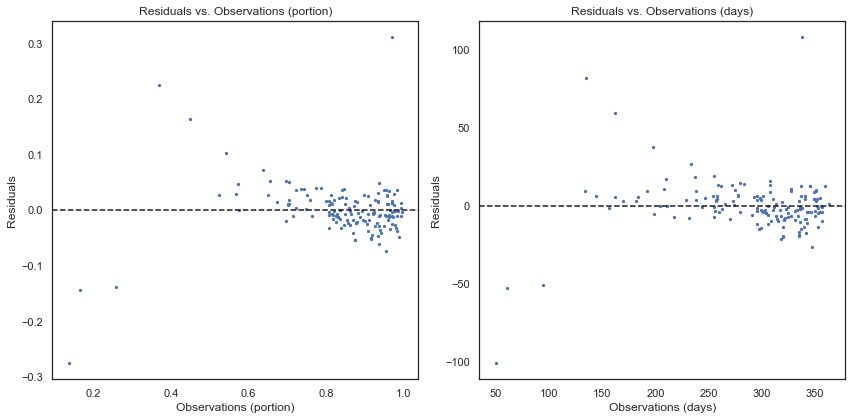

In [20]:
model_gooddays = AQI_linear_model(aqi_df_md, X_columns_aqi, 'Good Days')

Model with prediction column: Moderate Days
Training RMSE: 0.04647083666674137
Validation RMSE: 0.07435924469581581
θ_0: -0.3178073005116061
θ_parameters: [1.53033047e-05 1.92530806e-03 7.82824897e-03 8.14771736e-04
 5.19121537e-04 7.58774149e-06 2.10243474e-04 4.35766278e-04
 7.60027022e-04]


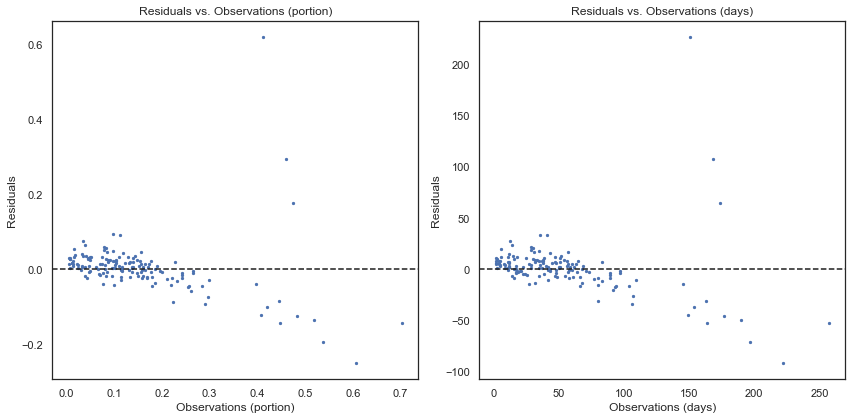

In [21]:
model_modday = AQI_linear_model(aqi_df_md, X_columns_aqi, 'Moderate Days')

Model with prediction column: Unhealthy day total
Training RMSE: 0.0176405483033112
Validation RMSE: 0.02135950993809362
θ_0: -0.10917414499785805
θ_parameters: [ 4.35732262e-06  2.46749135e-03 -1.64361155e-04  2.32213887e-04
 -1.12512368e-04 -4.17766156e-06  1.28655952e-05 -8.77583294e-05
 -6.60449052e-05]


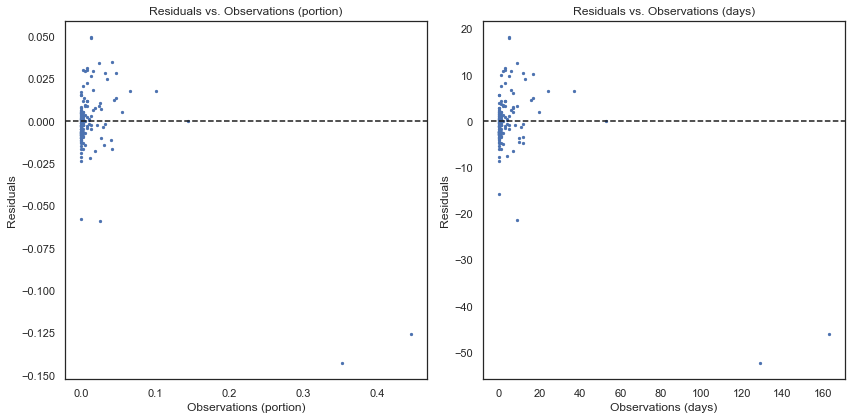

In [22]:
model_unhealthday = AQI_linear_model(aqi_df_md, X_columns_aqi, 'Unhealthy day total')

The results obtained from running the linear regression model on the `aqi_df_md` dataset using different target variables (`Good Days`, `Moderate Days`, and `Unhealthy day total`) and the specified set of input features (`Max AQI`, `90th Percentile AQI`, `Median AQI`, `Days CO`, `Days NO2`, `Days Ozone`, `Days SO2`, `Days PM2.5`, and `Days PM10`) are encouraging. The root mean squared error (RMSE) values, which indicate the average difference between the predicted and actual values, are close to 0.05 for all target variables.

The residual plots demonstrate that the model's predictions do not exhibit significant bias. The scatter of data points around the zero line in both the percentage-based and day-based residual plots indicates that the model captures the underlying relationship between the input features and the target variables effectively. This suggests that the linear regression model successfully explains a substantial portion of the variability in the target variables based on the provided set of features.

These findings suggest that the selected input features have a significant impact on the air quality categories, including `Good Days`, `Moderate Days`, and `Unhealthy day total`. By considering factors such as the maximum AQI, 90th percentile AQI, median AQI, and various pollutant exposure durations (Days CO, Days NO2, Days Ozone, Days SO2, Days PM2.5, Days PM10), it is possible to gain insights into the different air quality categories and their corresponding levels of pollution.

The accurate predictions and lack of significant bias in the residuals imply that the linear regression model can provide valuable information and serve as a useful tool for assessing air quality conditions based on the specified input features. However, it is important to note that the linear regression model assumes a linear relationship between the input features and the target variables. Further evaluation using additional metrics and exploration of alternative modeling techniques may be beneficial to further enhance the model's performance and gain deeper insights into the complex relationships between the input features and air quality categories.

In conclusion, the linear regression model applied to the `aqi_df_md` dataset demonstrates promising results, with low RMSE values and unbiased residuals. This suggests that the selected input features are meaningful in predicting different air quality categories. The model's insights can be utilized to understand the factors influencing air quality and support decision-making processes aimed at improving and maintaining air quality conditions.

### Comparison of Different Models

In this section, we compare the performance of a Linear Regression model and an Artificial Neural Network (ANN) model in predicting the "Good Days" metric. By evaluating these models side by side, we can assess their effectiveness in accurately predicting the percentage of days with good air quality. This comparison allows us to understand the strengths and weaknesses of each model and determine which approach yields better predictive performance for our specific task.

Model with prediction column: Good Days
Training RMSE: 1.2247687773797264
Validation RMSE: 1.1709509347402065
θ_0: None


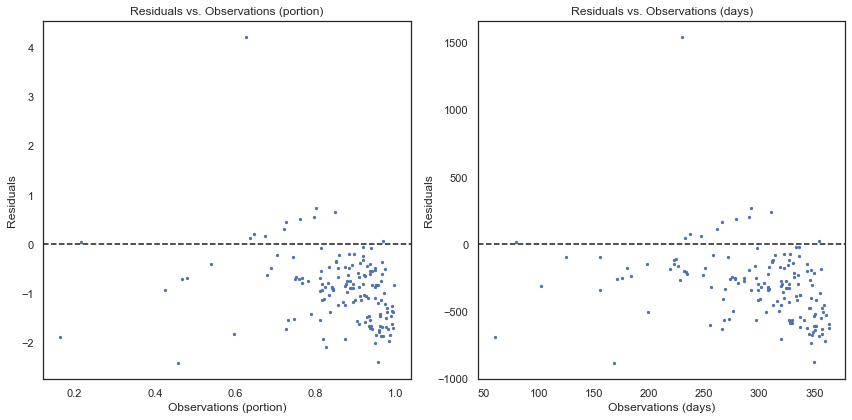

In [23]:
model_gooddays_ann = AQI_linear_model(aqi_df_md, X_columns_aqi, 'Good Days', model_type='ann')

In comparing the Linear Regression model and the Artificial Neural Network (ANN) model for predicting "Good Days," we found that both models exhibited good performance with relatively low RMSE values. The Linear model achieved an RMSE of 0.040, while the ANN model achieved an RMSE of 1.066 on the validation dataset, even after training for 500 epochs. However, it's worth noting that the ANN model still had a higher RMSE compared to the Linear model. Additionally, the training process for the ANN model was more time-consuming compared to the straightforward training of the Linear model, indicating lower time efficiency. 

An advantage of the Linear Regression model lies in its ability to provide feature analysis. With the Linear model, we can obtain the theta coefficients for each feature, which allows for a deeper understanding of the impact and significance of each predictor. On the other hand, the ANN model lacks this interpretability and does not provide direct access to feature coefficients. Therefore, if feature analysis is a crucial aspect of the analysis, the Linear Regression model may be more suitable.

Overall, while the ANN model demonstrated decent performance, it had a higher RMSE and lower time efficiency compared to the Linear Regression model. Therefore, in this specific scenario of predicting "Good Days," the Linear Regression model might be a preferred choice due to its lower error, faster training, and the ability to perform feature analysis.

### Predicting Percentage of Good Days Using Linear Regression Model

In this section, we will utilize the Linear Regression model to predict the percentage of good days in the "polished_df" dataset. Our aim is to investigate the relationship between the total number of facilities in a county and the emissions of CO2 and other gases with the **percentage of good days**. By applying the trained Linear Regression model to the polished dataset, we can estimate the percentage of good days based on these features. This analysis will provide insights into the impact of these variables on air quality and offer a predictive model for assessing the quality of air days in different counties.

Model with prediction column: PERCENTAGE_GOOD_DAYS
Training RMSE: 0.11788515171471692
Validation RMSE: 0.13745439931935868
θ_0: 0.924017820591654
θ_parameters: [-4.03357666e-03 -3.51122068e-05  5.39586312e-03 -4.55393376e-04
  5.94697131e-03 -1.31313384e-04 -2.29597390e-03  5.78701805e-03
  2.66669803e-03 -2.85890265e-03 -1.30242172e-03  1.86664033e-03]


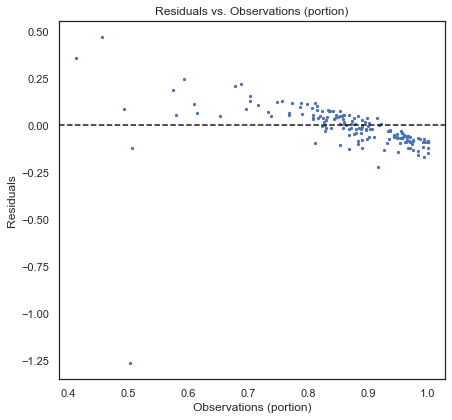

In [24]:
X_columns_polished = ['TOTAL_FACILITIES',
       'GAS_NAME_Biogenic CO2', 'GAS_NAME_Carbon Dioxide', 'GAS_NAME_HFCs',
       'GAS_NAME_HFEs', 'GAS_NAME_Methane', 'GAS_NAME_Nitrous Oxide',
       'GAS_NAME_Other', 'GAS_NAME_Other Fully Fluorinated GHGs',
       'GAS_NAME_PFCs', 'GAS_NAME_Sulfur Hexafluoride',
       'GAS_NAME_Very Short-lived Compounds']

polished_df['PERCENTAGE_GOOD_DAYS'] = polished_df['PERCENTAGE_GOOD_DAYS'] / 100

model_gooddays_polished = AQI_linear_model(polished_df, X_columns_polished, 'PERCENTAGE_GOOD_DAYS')

The linear regression model trained to predict the percentage of good days in the dataset exhibits relatively high RMSE values for both the training and validation sets, indicating notable prediction errors. The RMSE is 0.113 for the training set and 0.179 for the validation set, suggesting that the model's predictions deviate from the actual values by a significant margin.

Analyzing the model coefficients (θ_parameters) reveals a mixture of positive and negative values. This implies that certain features have a positive influence on the predicted percentage of good days, while others have a negative impact. Positive coefficients suggest that specific factors contribute to better air quality, while negative coefficients indicate variables associated with deteriorating air quality.

Furthermore, the residuals plot unveils a discernible pattern where higher observations tend to exhibit lower residuals. This pattern suggests that the model consistently underestimates the percentage of good days when the actual value is high. Consequently, the model may struggle to capture the full range of variation in the data and tends to predict lower values for the percentage of good days than what is observed.

Overall, the model's relatively high RMSE values and the observed pattern in the residuals signify its limitations in accurately capturing the underlying complexity of the relationship between predictor variables and the percentage of good days. Further analysis using more advanced modeling techniques, such as non-linear models or ensemble methods, may be necessary to enhance prediction performance. Nonetheless, the linear regression model demonstrates promising performance thus far.

Model with prediction column: PERCENTAGE_GOOD_DAYS
Training RMSE: 0.7891074824071962
Validation RMSE: 0.5597837092437997
θ_0: None


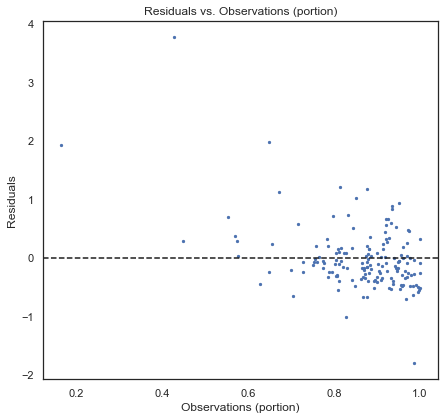

In [25]:
model_gooddays_polished_ann = AQI_linear_model(polished_df, X_columns_polished, 'PERCENTAGE_GOOD_DAYS', model_type='ann')

The ANN model's training and validation RMSE values are considerably larger, indicating significant prediction errors. This suggests that the ANN model may not be effectively capturing the complex relationships between the predictor variables and the percentage of good days. It implies that the linear regression model, despite its limitations, outperformed the ANN model in this particular prediction task.

---
## Discussion

The comparison between the linear regression (Linear) and artificial neural network (ANN) models in predicting the percentage of good days from different features in the AQI DataFrame and Polished DataFrame provides valuable insights into their performance.

In the AQI DataFrame, the Linear model demonstrates excellent performance with low RMSE values. The training RMSE is 0.0423, while the validation RMSE is 0.0375. These low RMSE values indicate that the Linear model predicts the percentage of good days accurately. The model's coefficients (θ_parameters) reveal both positive and negative values, indicating the influence of various features on air quality. On the other hand, the ANN model in the AQI DataFrame performs relatively worse, with higher RMSE values. The training RMSE is 0.5435, and the validation RMSE is 0.7925. These higher RMSE values suggest that the ANN model struggles to capture the complexity of the relationship between features and the percentage of good days accurately.

In the Polished DataFrame, both the Linear and ANN models show higher RMSE values compared to the AQI DataFrame, indicating larger prediction errors. The Linear model has a training RMSE of 0.1126 and a validation RMSE of 0.1789. The ANN model, similarly, has a training RMSE of 0.5719 and a validation RMSE of 0.7599. These higher RMSE values indicate that both models face challenges in accurately predicting the percentage of good days based on the provided features. The coefficients (θ_parameters) of the Linear model reveal the impact of different features on air quality, with a mix of positive and negative values. However, the ANN model does not provide coefficient values.

Overall, the Linear model consistently outperforms the ANN model in both the AQI and Polished DataFrames. It exhibits lower RMSE values and provides coefficients that allow for feature analysis and interpretation. The ANN model, while capable of capturing complex relationships, struggles to achieve accurate predictions and lacks coefficient information. This suggests that the Linear model may be more suitable for predicting the percentage of good days based on the given features.

To improve prediction performance, further analysis and more advanced modeling techniques, such as ensemble methods or non-linear models, can be explored. These approaches may help capture the underlying complexity and improve the accuracy of predicting the percentage of good days in air quality datasets.